In [1]:
import torch
import torchvision
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torch.utils.data import Dataset, DataLoader
import os
import cv2

In [2]:
class MosquitoDataset(Dataset):
    def __init__(self, images_dir, labels_dir, img_size=640):
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        self.image_files = [f for f in os.listdir(images_dir) if f.endswith(".jpeg")]
        self.img_size = img_size  # Resize images to this size

    def __len__(self):
        return len(self.image_files)

    def convert_yolo_to_pascal(self, label_file, img_width, img_height, new_width, new_height):
        """Convert YOLO annotations to Pascal VOC format and adjust for resized dimensions."""
        converted_labels = []
        scale_x = new_width / img_width
        scale_y = new_height / img_height

        with open(label_file, 'r') as file:
            for line in file:
                class_id, center_x, center_y, width, height = map(float, line.strip().split())

                # Convert YOLO (center_x, center_y, width, height) to Pascal VOC (x_min, y_min, x_max, y_max)
                x_min = (center_x - width / 2) * img_width
                y_min = (center_y - height / 2) * img_height
                x_max = (center_x + width / 2) * img_width
                y_max = (center_y + height / 2) * img_height

                # Adjust bounding box to the new image size
                x_min *= scale_x
                y_min *= scale_y
                x_max *= scale_x
                y_max *= scale_y

                converted_labels.append([class_id, x_min, y_min, x_max, y_max])

        return converted_labels

    def __getitem__(self, idx):
        # Image file path
        img_name = self.image_files[idx]
        img_path = os.path.join(self.images_dir, img_name)
        label_path = os.path.join(self.labels_dir, img_name.replace(".jpeg", ".txt"))

        # Load image
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Get original dimensions
        orig_height, orig_width, _ = img.shape

        # Resize the image
        img = cv2.resize(img, (self.img_size, self.img_size))
        new_height, new_width = self.img_size, self.img_size

        # Convert YOLO annotations to Pascal VOC and adjust for resized dimensions
        pascal_labels = self.convert_yolo_to_pascal(label_path, orig_width, orig_height, new_width, new_height)

        boxes = []
        labels = []
        for label in pascal_labels:
            class_id, x_min, y_min, x_max, y_max = label
            boxes.append([x_min, y_min, x_max, y_max])
            labels.append(class_id)

        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        target = {"boxes": boxes, "labels": labels}

        img = torch.tensor(img, dtype=torch.float32).permute(2, 0, 1) / 255.0  # Normalize to [0, 1]

        return img, target


In [3]:

def build_model(num_classes):
    # pre-trained ResNet-18 backbone
    backbone = torchvision.models.resnet18(weights=torchvision.models.ResNet18_Weights.DEFAULT)
    backbone = torch.nn.Sequential(*list(backbone.children())[:-2])  # Remove FC layer and avg pool
    backbone.out_channels = 512  # Output channels of ResNet-18

    # RPN anchor generator
    anchor_generator = AnchorGenerator(
        sizes=((32, 64, 128, 256, 512),),
        aspect_ratios=((0.5, 1.0, 2.0),) * 5,
    )

    # ROI pooler
    roi_pooler = torchvision.ops.MultiScaleRoIAlign(
        featmap_names=["0"], output_size=7, sampling_ratio=2
    )

    model = FasterRCNN(
        backbone,
        num_classes=num_classes,
        rpn_anchor_generator=anchor_generator,
        box_roi_pool=roi_pooler,
    )
    return model


In [ ]:
datafolder = "simple_dataset"
batch_size = 4

train_dataset = MosquitoDataset(f"datasets/{datafolder}/images/train", f"datasets/{datafolder}/labels/train")
val_dataset = MosquitoDataset(f"datasets/{datafolder}/images/val", f"datasets/{datafolder}/labels/val")
test_dataset = MosquitoDataset(f"datasets/{datafolder}/images/test", f"datasets/{datafolder}/labels/test")


train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))


In [ ]:
model = build_model(num_classes=7)  # 6 classes + 1 background
optimizer = torch.optim.SGD(model.parameters(), lr=0.005, momentum=0.9, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

In [ ]:

def train(model, optimizer, scheduler, trainloader, valloader, device, num_epochs, save_dir, save_name):
    """
    Train and validate the model for num_epochs
    
    Args:
    - model: The Faster R-CNN model.
    - optimizer: Optimizer for training.
    - scheduler: Learning rate scheduler.
    - trainloader: DataLoader for the training dataset.
    - valloader: DataLoader for the validation dataset.
    - device: Device to use ('cuda' or 'cpu').
    - num_epochs: Number of epochs to train.
    - save_dir: Directory to save the models.
    - save_name: Name of the best model to save.
    """
    best_val_loss = float("inf")
    train_losses, val_losses = [], []
    os.makedirs(save_dir, exist_ok=True)
    model = model.to(device)
    for epoch in range(num_epochs):
        # Training Loop
        model.train()
        train_loss = 0.0

        for images, targets in tqdm(trainloader):
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Forward pass and loss computation
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

            # Backward pass and optimizer step
            optimizer.zero_grad()
            losses.backward()
            optimizer.step()

            train_loss += losses.item()

        train_loss /= len(trainloader)
        train_losses.append(train_loss)

        # Validation Loop
        model.eval()
        val_loss = 0.0

        with torch.no_grad():
            for images, targets in valloader:
                images = list(image.to(device) for image in images)
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

                # Compute loss (requires switching back to train mode temporarily)
                model.train()
                loss_dict = model(images, targets)
                losses = sum(loss for loss in loss_dict.values())
                model.eval()  # Switch back to evaluation mode

                val_loss += losses.item()

        val_loss /= len(valloader)
        val_losses.append(val_loss)

        print(f"Epoch [{epoch+1}/{num_epochs}] | Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")

        # Save the model for the current epoch
        torch.save(model.state_dict(), os.path.join(save_dir, f"model_epoch_{epoch+1}.pth"))

        # Save the best model
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), os.path.join(save_dir, save_name))
            print(f"Best model saved with val loss: {val_loss:.4f}")

        scheduler.step()

    return train_losses, val_losses

In [ ]:
num_epochs = 5
save_dir = "/models/{datafolder}/"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

train_losses, val_losses=  train(
    model=model,
    optimizer=optimizer,
    scheduler=scheduler,
    train_loader=train_loader,
    val_loader=val_loader,
    device=device,
    num_epochs=num_epochs,
    save_dir=save_dir,
    save_name="best_model.pth"
)


Epoch 1/5 - Training:   0%|          | 0/1652 [00:00<?, ?it/s]

Epoch 1/5 - Validation:   0%|          | 0/294 [00:00<?, ?it/s]

Epoch [1/5] | Train Loss: 0.1833 | Val Loss: 0.1545
Best model updated at epoch 1 with Val Loss: 0.1545


Epoch 2/5 - Training:   0%|          | 0/1652 [00:00<?, ?it/s]

Epoch 2/5 - Validation:   0%|          | 0/294 [00:00<?, ?it/s]

Epoch [2/5] | Train Loss: 0.1485 | Val Loss: 0.1454
Best model updated at epoch 2 with Val Loss: 0.1454


Epoch 3/5 - Training:   0%|          | 0/1652 [00:00<?, ?it/s]

Epoch 3/5 - Validation:   0%|          | 0/294 [00:00<?, ?it/s]

Epoch [3/5] | Train Loss: 0.1309 | Val Loss: 0.1336
Best model updated at epoch 3 with Val Loss: 0.1336


Epoch 4/5 - Training:   0%|          | 0/1652 [00:00<?, ?it/s]

Epoch 4/5 - Validation:   0%|          | 0/294 [00:00<?, ?it/s]

Epoch [4/5] | Train Loss: 0.1128 | Val Loss: 0.1250
Best model updated at epoch 4 with Val Loss: 0.1250


Epoch 5/5 - Training:   0%|          | 0/1652 [00:00<?, ?it/s]

Epoch 5/5 - Validation:   0%|          | 0/294 [00:00<?, ?it/s]

Epoch [5/5] | Train Loss: 0.1074 | Val Loss: 0.1267
Training Completed!


In [12]:
model.load_state_dict(torch.load("frcnn18_models/best_model.pth"))

C:\Users\aryam\AppData\Local\Temp\ipykernel_38176\1362869139.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("frcnn18_models/best_model.

<All keys matched successfully>

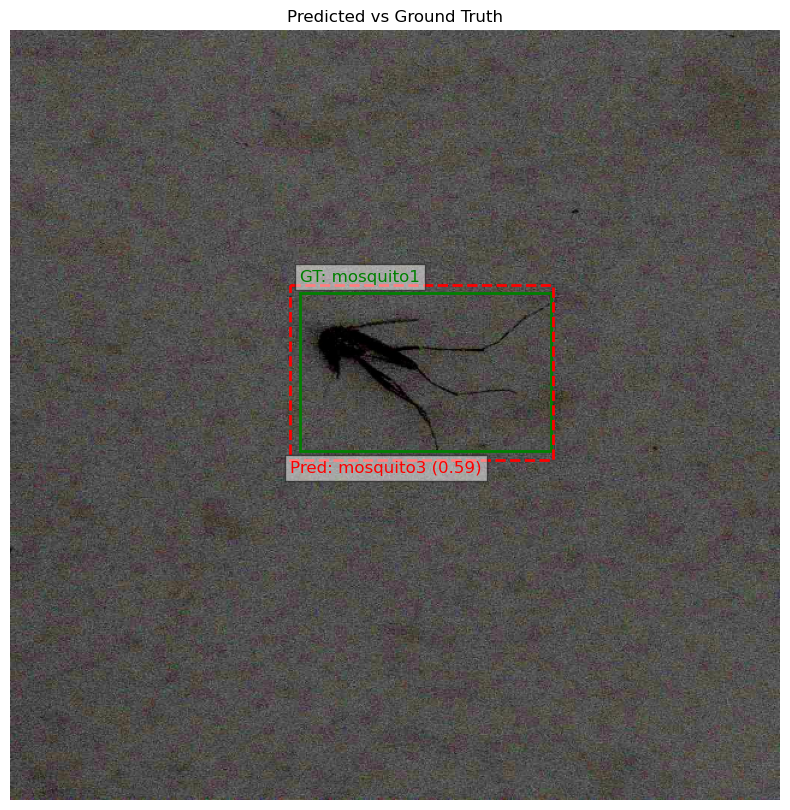

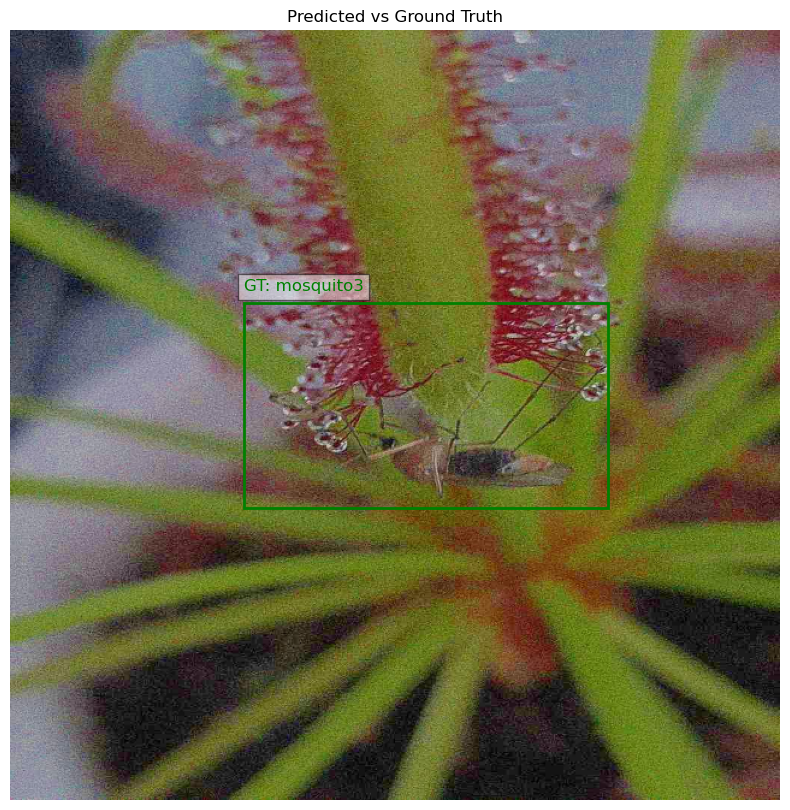

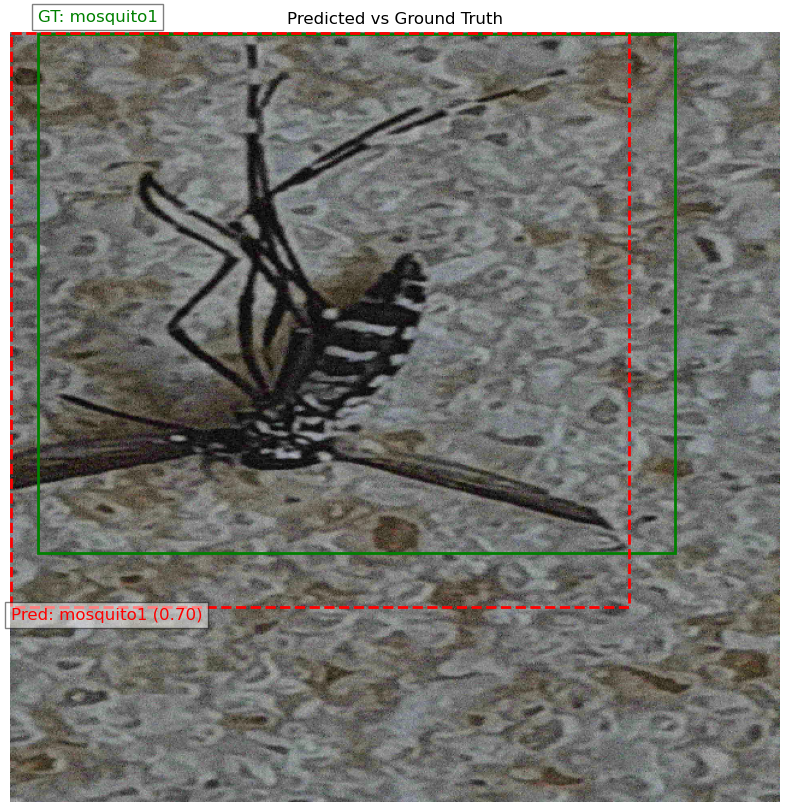

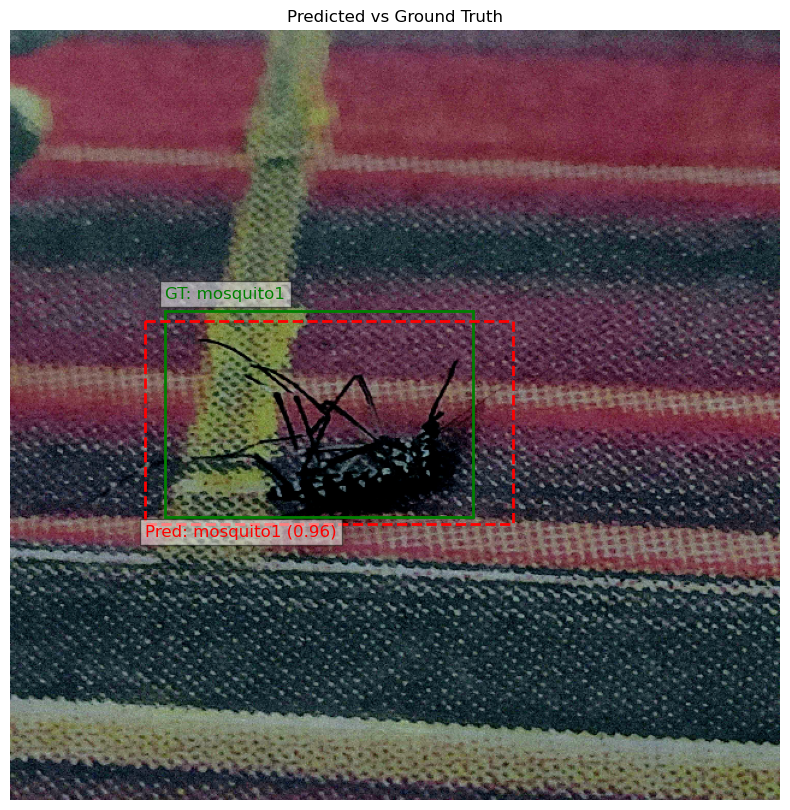

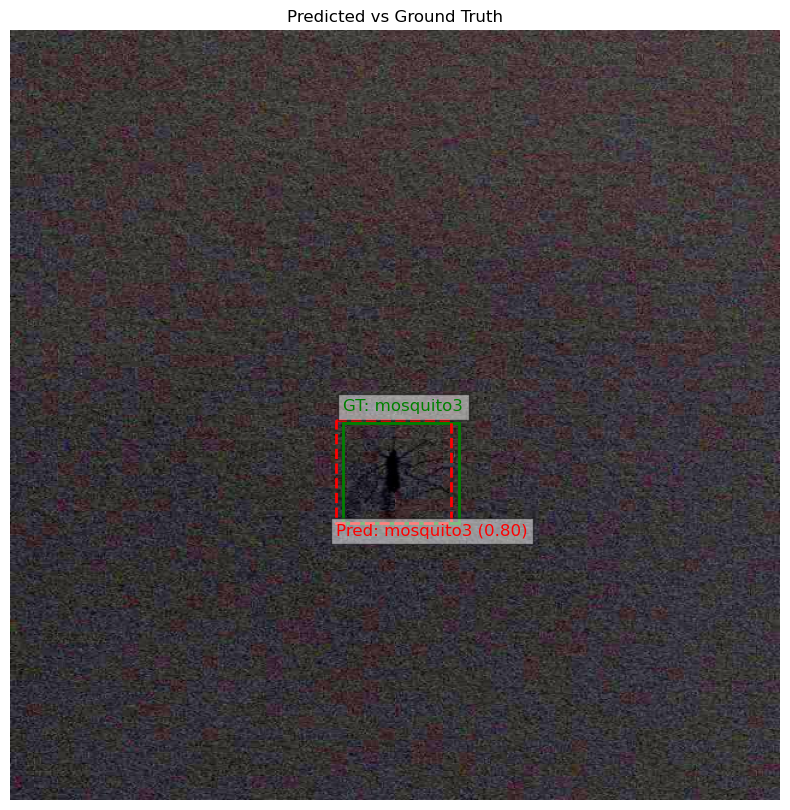

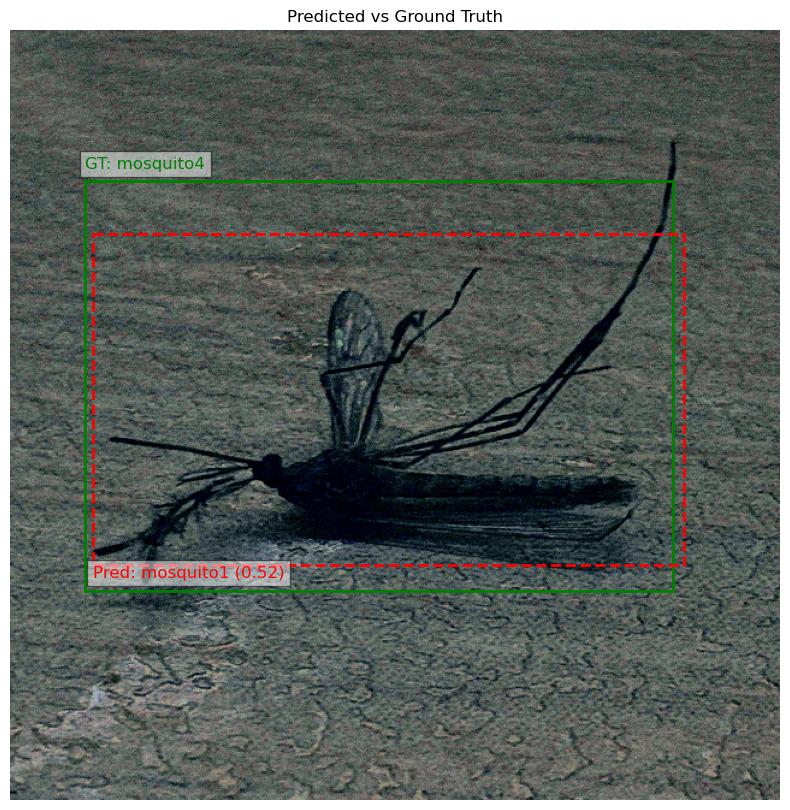

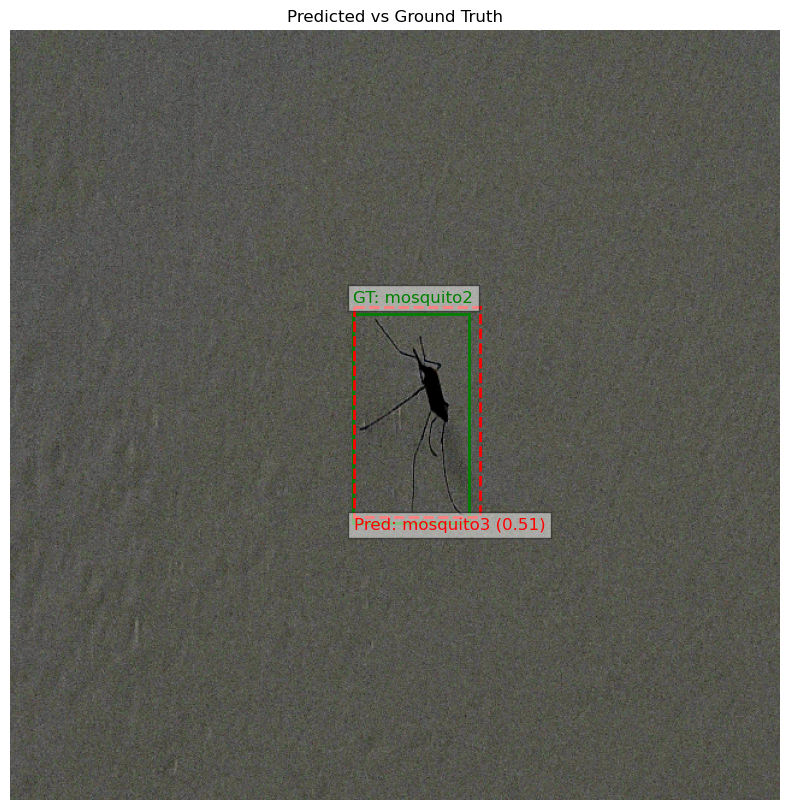

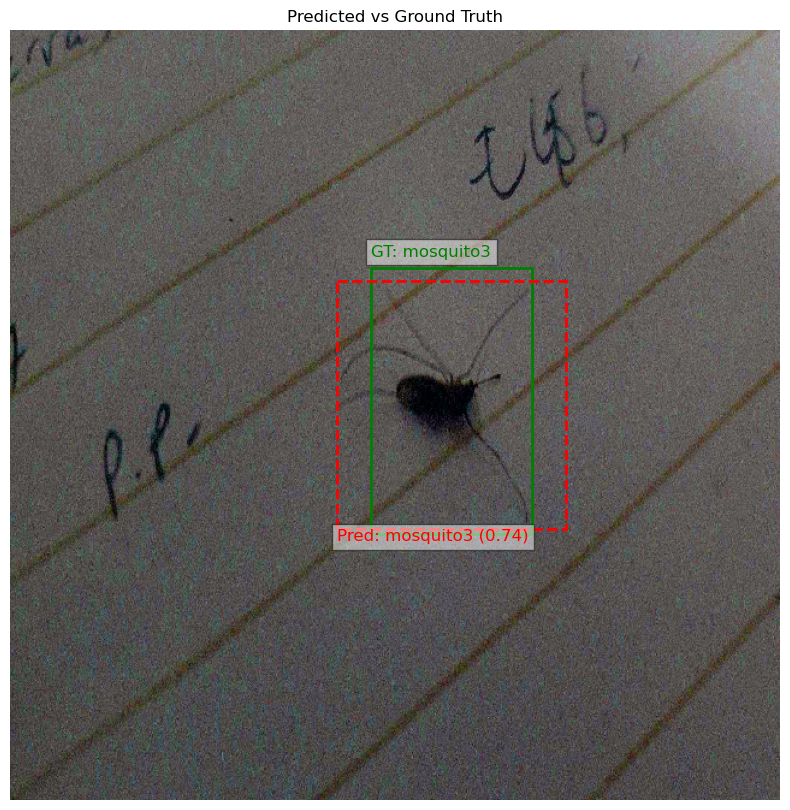

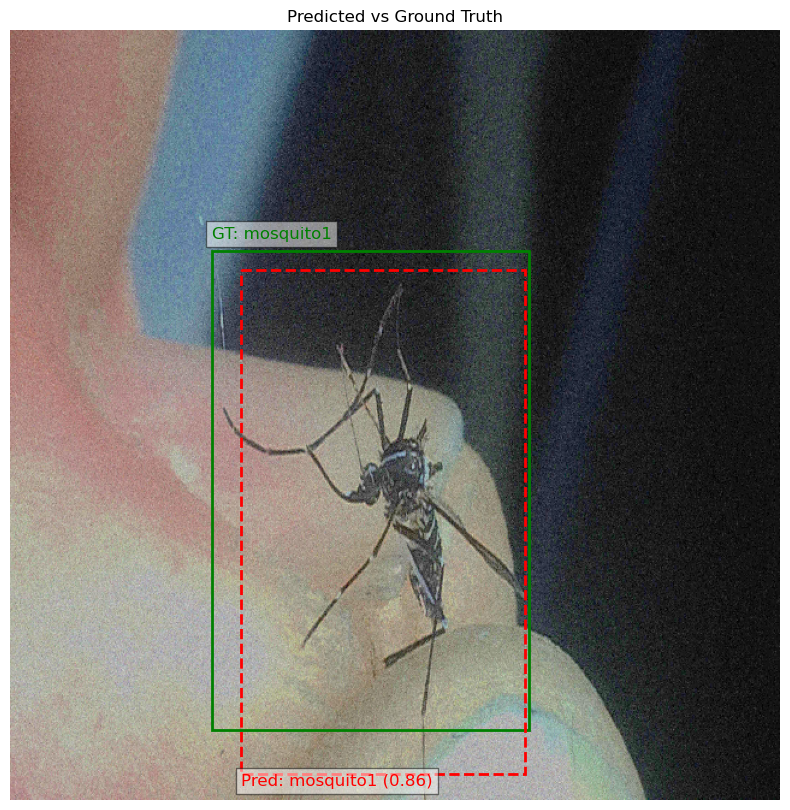

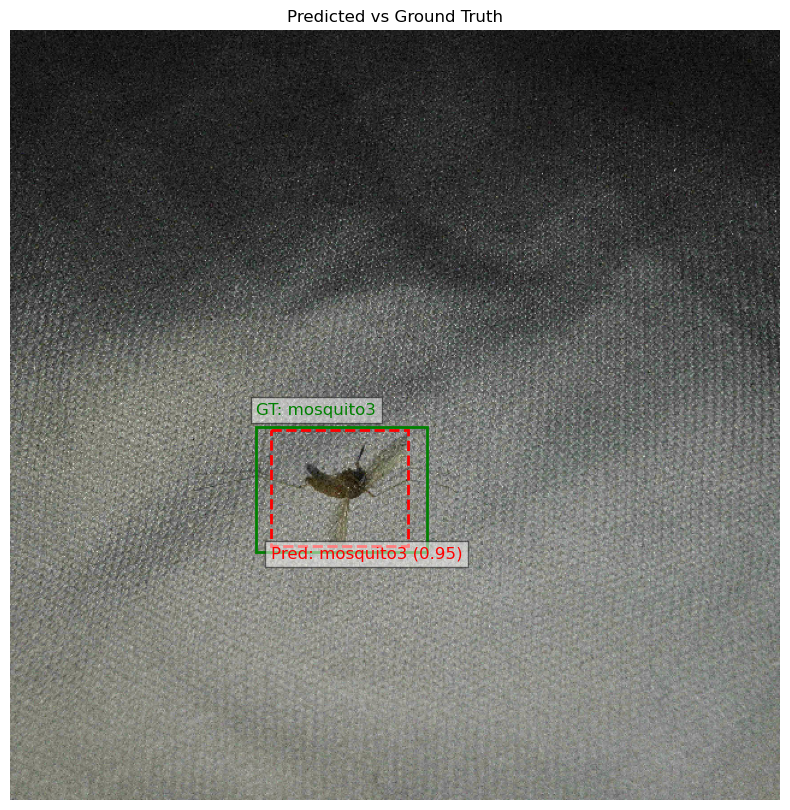

In [ ]:
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_pil_image

def plot_predictions_vs_ground_truth(model, data_loader, device, class_labels, num_samples=5, confidence_threshold=0.5):
    """
    Plot predicted and ground truth bounding boxes and labels for samples from the validation dataset.

    Args:
        model: Trained Faster R-CNN model.
        data_loader: DataLoader for validation data.
        device: Device for computation (e.g., "cuda" or "cpu").
        class_labels: List of class labels corresponding to class IDs.
        num_samples: Number of samples to visualize.
        confidence_threshold: Minimum confidence score for displaying predictions.
    """
    model.eval()  # Set model to evaluation mode

    with torch.no_grad():
        for idx in range(num_samples):
            # Load the image and target from the dataset
            img, target = data_loader.dataset[idx]

            # Move the image to the device
            img = img.to(device).unsqueeze(0)  # Add batch dimension

            # Get model predictions
            output = model(img)[0]  # Model returns a list of outputs

            # Extract predictions
            pred_boxes = output["boxes"].cpu().numpy()
            pred_labels = output["labels"].cpu().numpy()
            pred_scores = output["scores"].cpu().numpy()

            # Extract ground truth
            true_boxes = target["boxes"].cpu().numpy()
            true_labels = target["labels"].cpu().numpy()

            # Convert the image tensor to a PIL image for plotting
            img = to_pil_image(img.squeeze(0).cpu())

            # Plot the image with bounding boxes
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            ax = plt.gca()

            # Plot ground truth bounding boxes
            for box, label in zip(true_boxes, true_labels):
                x_min, y_min, x_max, y_max = box

                # Draw the bounding box (green for ground truth)
                rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                     edgecolor="green", facecolor="none", linewidth=2)
                ax.add_patch(rect)

                # Add the label
                label_text = f"GT: {class_labels[label]}"
                ax.text(x_min, y_min - 10, label_text, color="green", fontsize=12, 
                        backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            # Plot predicted bounding boxes
            for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
                if score > confidence_threshold:  # Plot only confident predictions
                    x_min, y_min, x_max, y_max = box

                    # Draw the bounding box (red for predictions)
                    rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                         edgecolor="red", facecolor="none", linewidth=2, linestyle="--")
                    ax.add_patch(rect)

                    # Add the label and score
                    label_text = f"Pred: {class_labels[label]} ({score:.2f})"
                    ax.text(x_min, y_max + 10, label_text, color="red", fontsize=12, 
                            backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            plt.axis("off")
            plt.title("Predicted vs Ground Truth")
            plt.show()

# Example usage
class_labels = ["background", "mosquito1", "mosquito2", "mosquito3", "mosquito4", "mosquito5", "mosquito6"]  # Replace with your class names
plot_predictions_vs_ground_truth(model, val_loader, device, class_labels, num_samples=10, confidence_threshold=0.5)


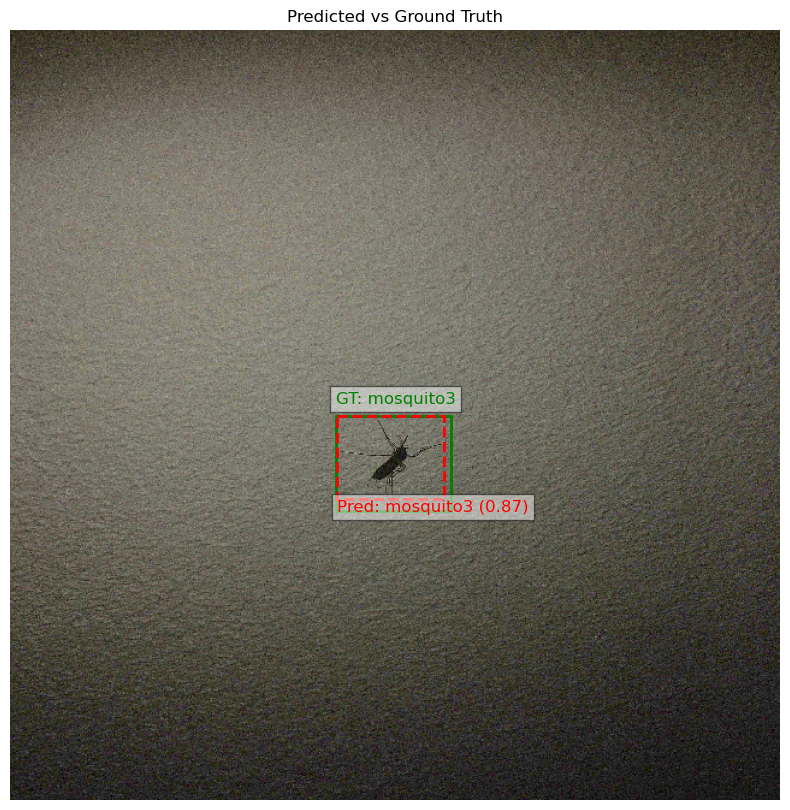

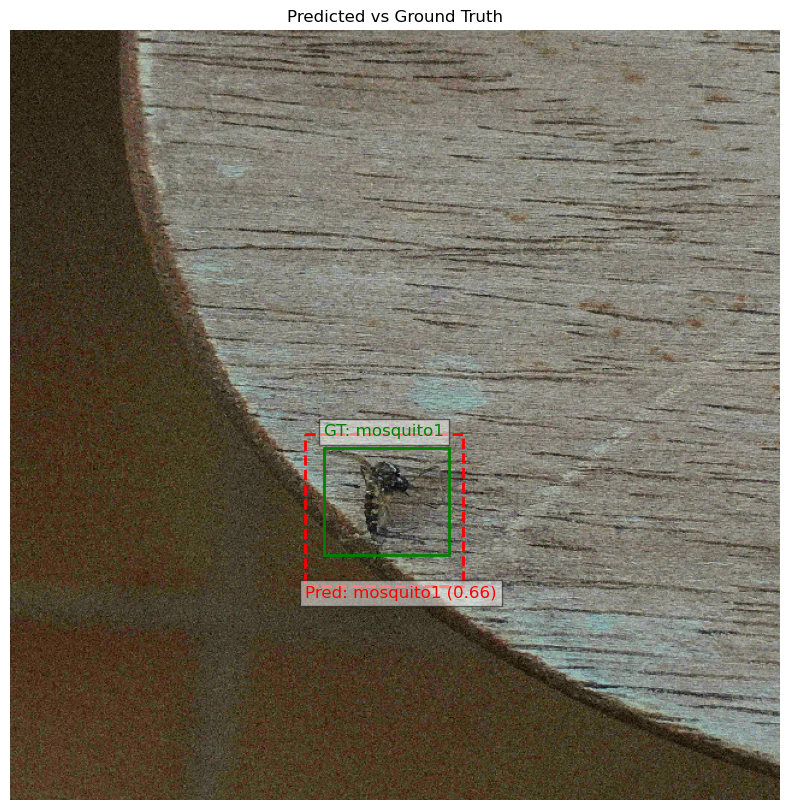

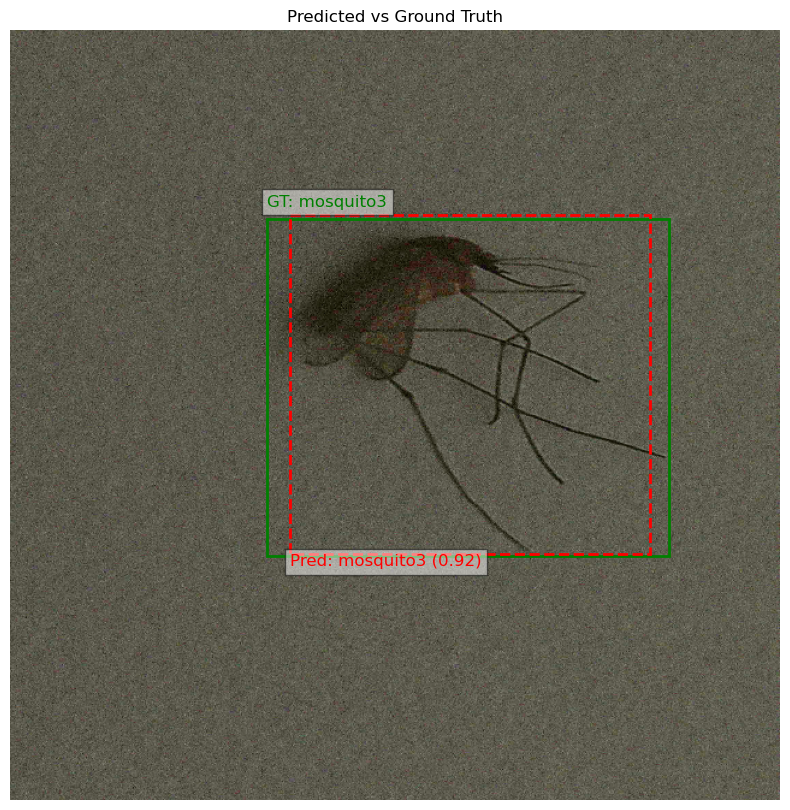

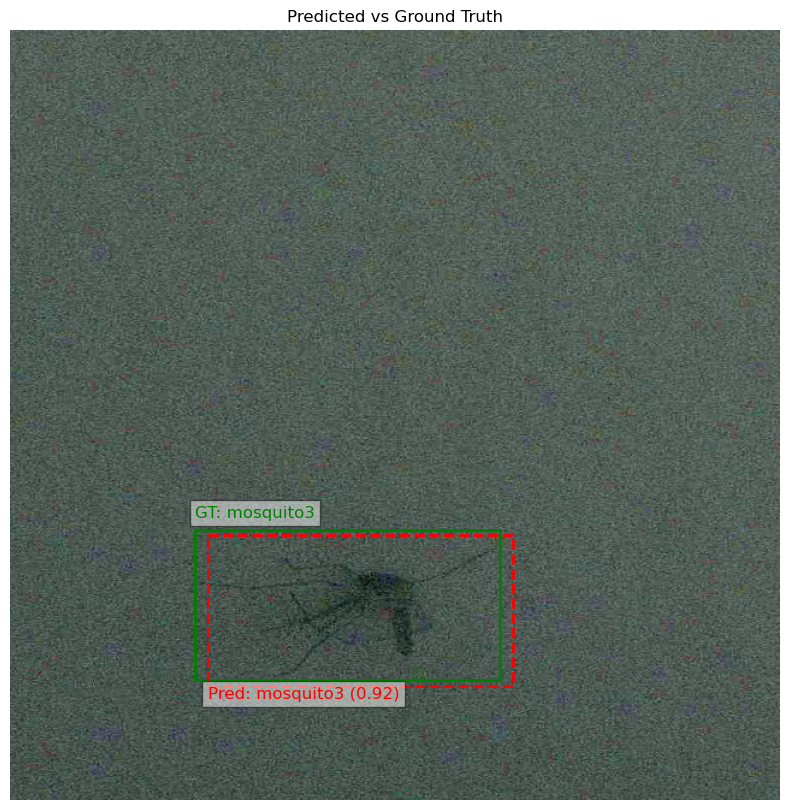

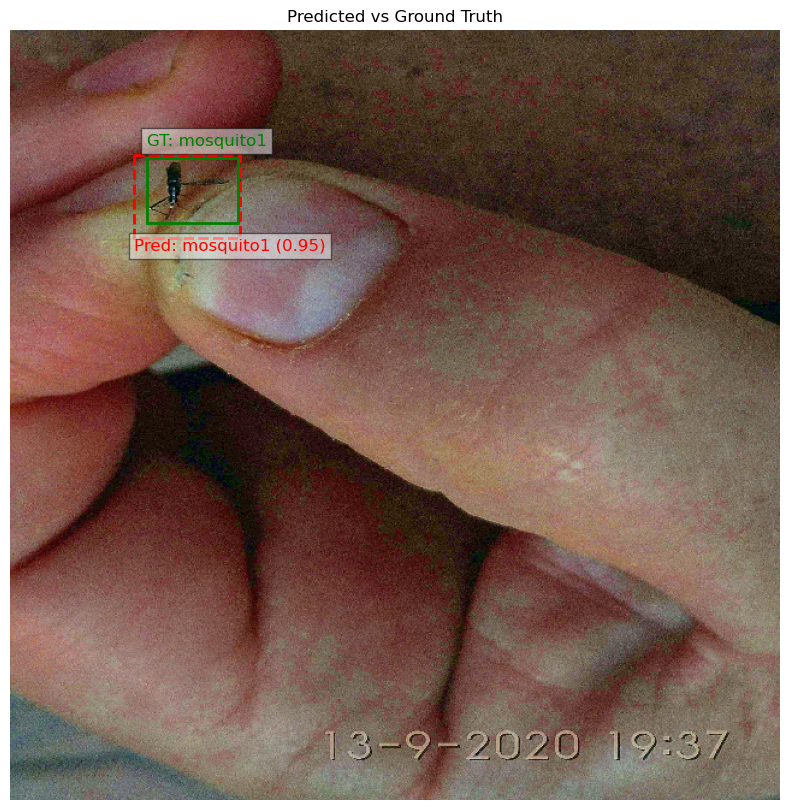

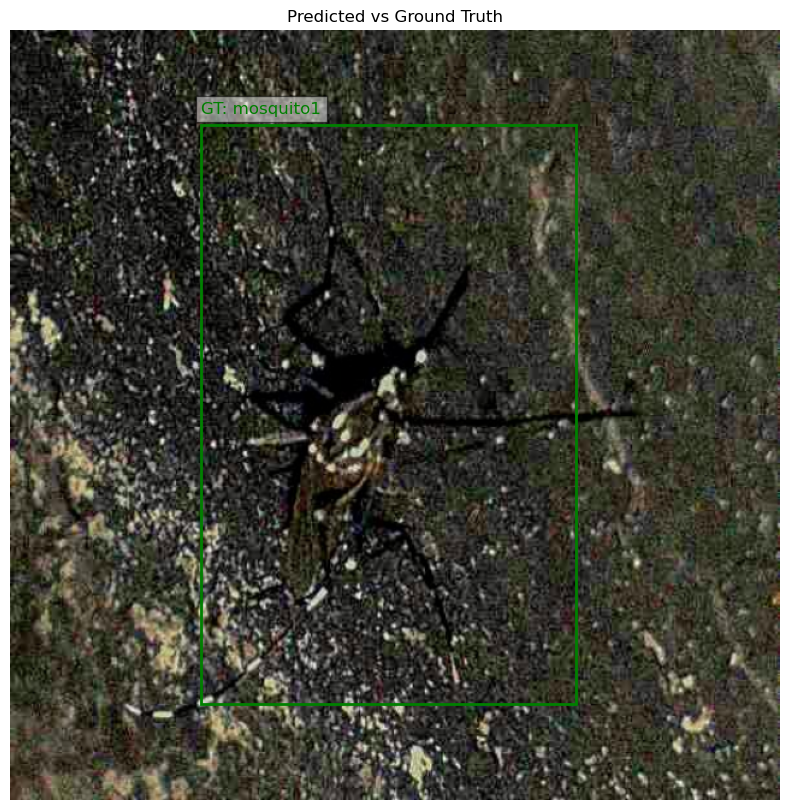

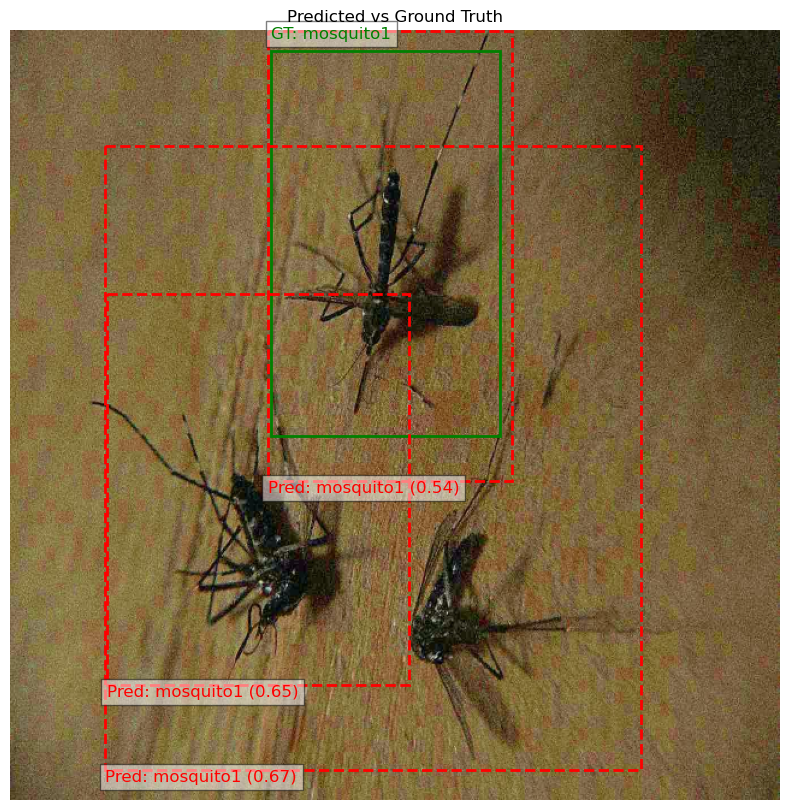

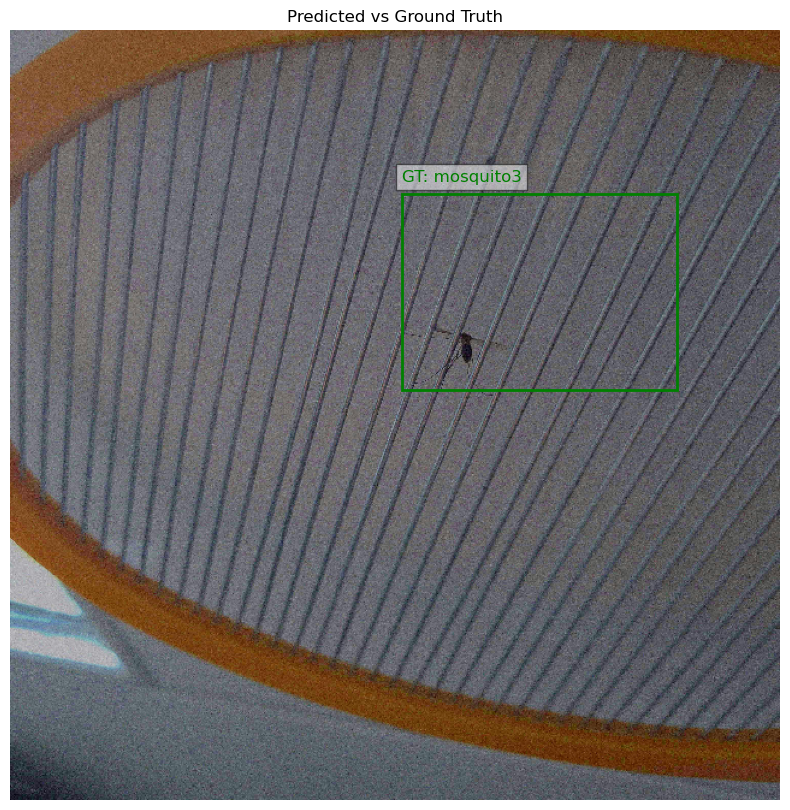

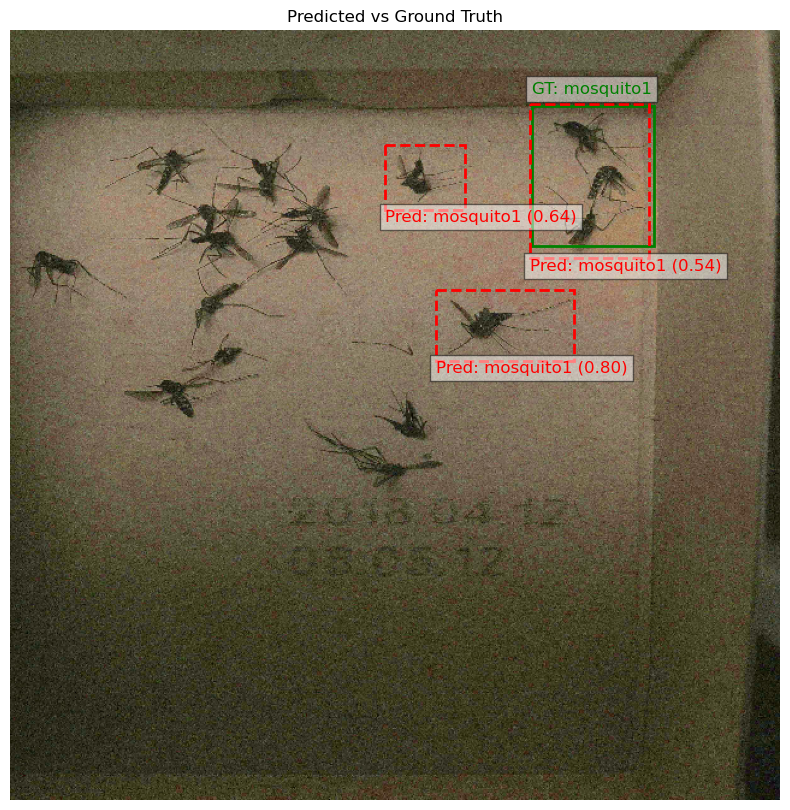

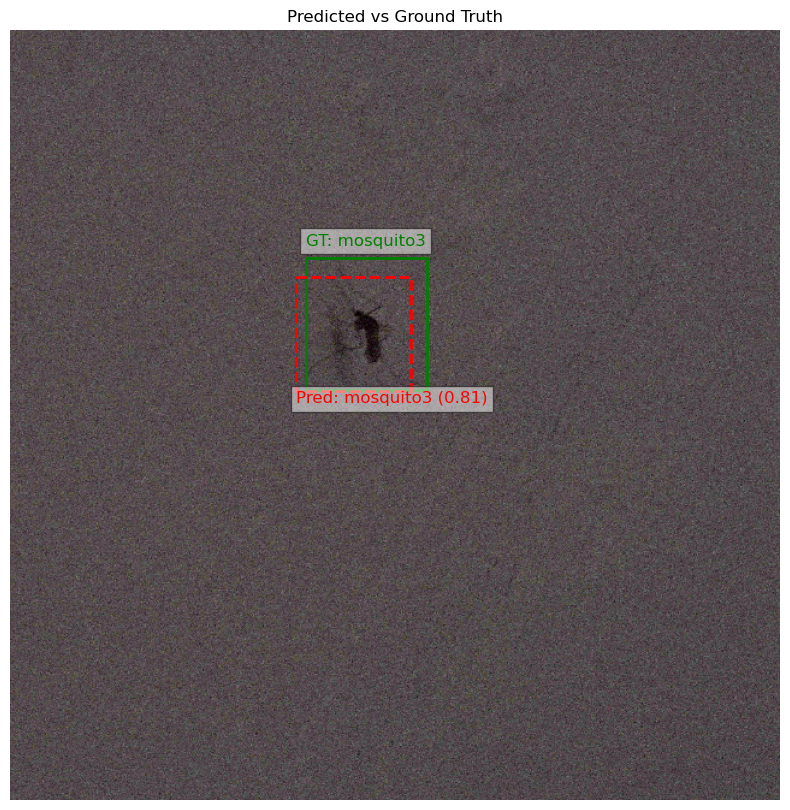

In [14]:
plot_predictions_vs_ground_truth(model, test_loader, device, class_labels, num_samples=10, confidence_threshold=0.5)

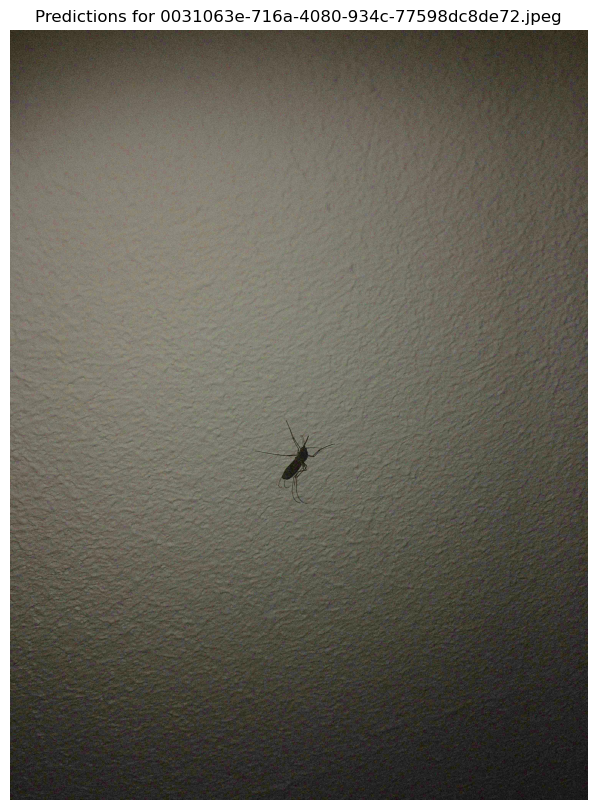

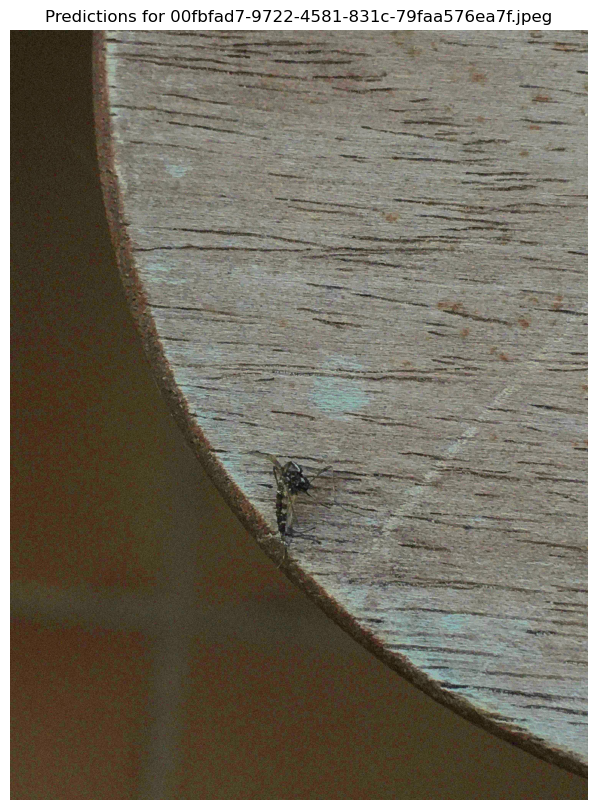

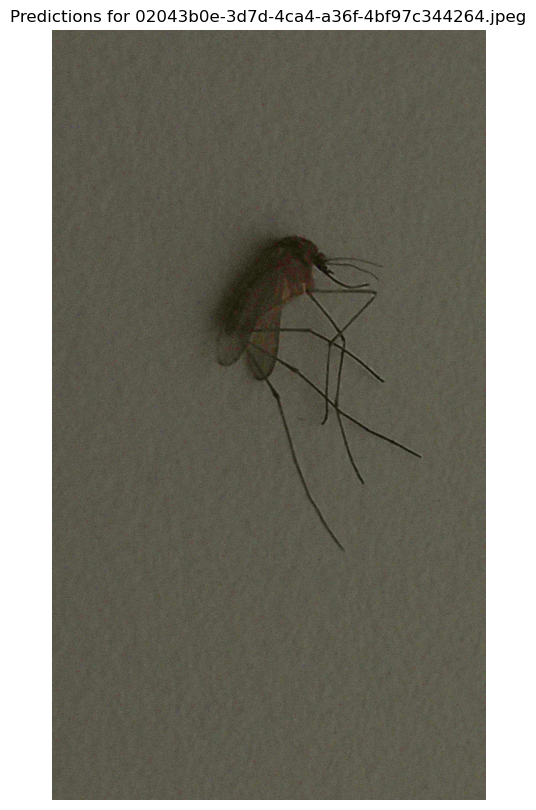

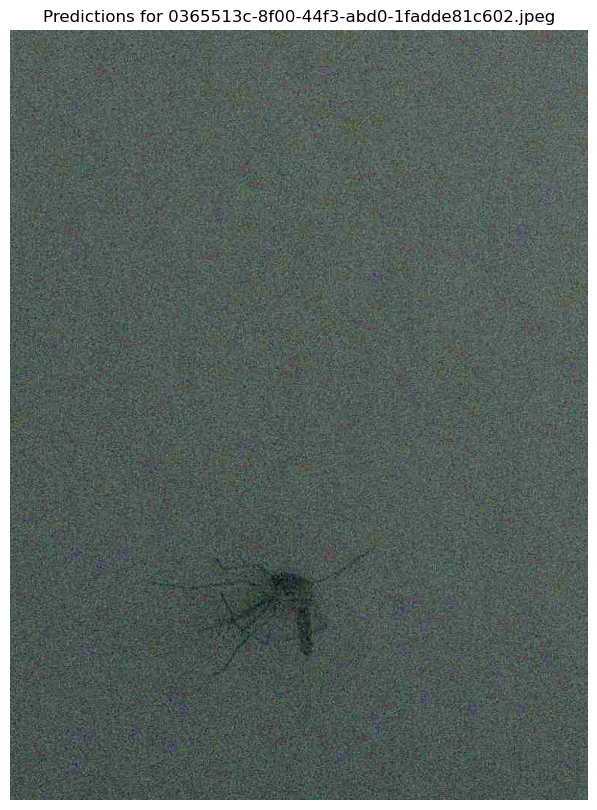

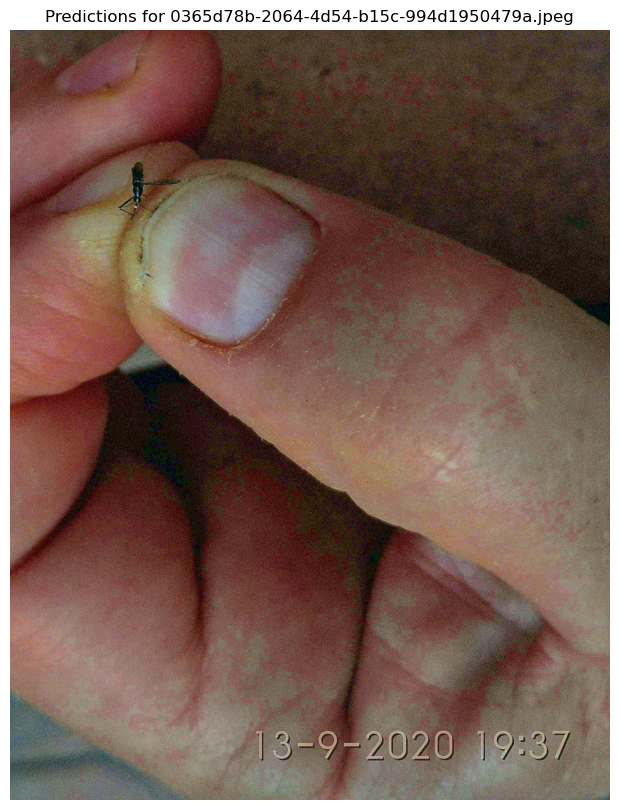

In [9]:
import os
import cv2
import torch
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_tensor

def plot_test_predictions_with_rescaling(model, test_folder, device, class_labels, img_size=640, num_samples=5, confidence_threshold=0.5):
    """
    Plot bounding boxes and class predictions for test images directly from the test folder (no loader).
    The bounding boxes are rescaled back to the original image dimensions for correct visualization.
    
    Args:
        model: Trained Faster R-CNN model.
        test_folder: Path to the test image folder.
        device: Device for computation (e.g., "cuda" or "cpu").
        class_labels: List of class labels corresponding to class IDs.
        img_size: Size to which test images are resized before input to the model.
        num_samples: Number of samples to visualize.
        confidence_threshold: Minimum confidence score for displaying predictions.
    """
    model.eval()  # Set model to evaluation mode

    # Get test image paths
    image_paths = [os.path.join(test_folder, f) for f in os.listdir(test_folder) if f.endswith((".jpeg", ".png"))]
    selected_images = image_paths[:num_samples]  # Select the first `num_samples` images

    with torch.no_grad():
        for image_path in selected_images:
            # Load the original image
            img = cv2.imread(image_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            orig_height, orig_width, _ = img.shape

            # Resize and normalize the image
            img_resized = cv2.resize(img, (img_size, img_size))
            img_tensor = to_tensor(img_resized).unsqueeze(0).to(device)  # Convert to tensor and add batch dimension

            # Get model predictions
            output = model(img_tensor)[0]  # Model returns a list of outputs

            # Extract predictions
            pred_boxes = output["boxes"].cpu().numpy()
            pred_labels = output["labels"].cpu().numpy()
            pred_scores = output["scores"].cpu().numpy()

            # Rescale bounding boxes to the original image size
            scale_x = orig_width / img_size
            scale_y = orig_height / img_size
            pred_boxes_rescaled = []
            for box in pred_boxes:
                x_min, y_min, x_max, y_max = box
                x_min *= scale_x
                y_min *= scale_y
                x_max *= scale_x
                y_max *= scale_y
                pred_boxes_rescaled.append([x_min, y_min, x_max, y_max])

            # Plot the image with bounding boxes
            plt.figure(figsize=(10, 10))
            plt.imshow(img)
            ax = plt.gca()

            # Plot predicted bounding boxes
            for box, label, score in zip(pred_boxes_rescaled, pred_labels, pred_scores):
                if score > confidence_threshold:  # Plot only confident predictions
                    x_min, y_min, x_max, y_max = box

                    # Draw the bounding box (red for predictions)
                    rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, 
                                         edgecolor="red", facecolor="none", linewidth=2, linestyle="--")
                    ax.add_patch(rect)

                    # Add the label and score
                    label_text = f"Pred: {class_labels[label]} ({score:.2f})"
                    ax.text(x_min, y_min - 10, label_text, color="red", fontsize=12, 
                            backgroundcolor="white", bbox=dict(facecolor="white", alpha=0.5))

            plt.axis("off")
            plt.title(f"Predictions for {os.path.basename(image_path)}")
            plt.show()

# Example usage
test_folder = "./datasets/dataset/images/test"  # Path to the test images folder
class_labels = ["background", "mosquito1", "mosquito2", "mosquito3", "mosquito4", "mosquito5", "mosquito6"]  # Replace with your class names
plot_test_predictions_with_rescaling(model, test_folder, device, class_labels, img_size=640, num_samples=5, confidence_threshold=0.5)


In [15]:
import torch
import numpy as np
from torchvision.ops import box_iou
from tqdm import tqdm

def calculate_f1_score(pred_boxes, pred_labels, pred_scores, true_boxes, true_labels, iou_threshold=0.5, score_threshold=0.5):
    """
    Calculate F1 score for a single image's predictions.

    Args:
        pred_boxes: Predicted bounding boxes (N x 4, numpy array).
        pred_labels: Predicted class labels (N, numpy array).
        pred_scores: Predicted confidence scores (N, numpy array).
        true_boxes: Ground truth bounding boxes (M x 4, numpy array).
        true_labels: Ground truth class labels (M, numpy array).
        iou_threshold: IoU threshold for matching predictions to ground truth.
        score_threshold: Confidence score threshold for valid predictions.

    Returns:
        tp: True positives.
        fp: False positives.
        fn: False negatives.
    """
    # Filter predictions based on confidence score
    valid_preds = pred_scores > score_threshold
    pred_boxes = pred_boxes[valid_preds]
    pred_labels = pred_labels[valid_preds]

    tp = 0
    fp = 0
    fn = 0

    if len(pred_boxes) > 0 and len(true_boxes) > 0:
        ious = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes))
        max_ious, max_indices = ious.max(dim=1)

        for pred_idx, max_iou in enumerate(max_ious):
            if max_iou > iou_threshold and pred_labels[pred_idx] == true_labels[max_indices[pred_idx]]:
                tp += 1
            else:
                fp += 1

        # Count false negatives (unmatched ground truth boxes)
        matched_gt = max_ious > iou_threshold
        fn = len(true_boxes) - matched_gt.sum().item()
    else:
        # All predictions are false positives if no ground truth exists
        fp = len(pred_boxes)
        # All ground truth boxes are false negatives if no predictions exist
        fn = len(true_boxes)

    return tp, fp, fn

def calculate_map(pred_boxes, pred_labels, pred_scores, true_boxes, true_labels, iou_threshold=0.5):
    """
    Calculate Mean Average Precision (mAP) for a single image's predictions.

    Args:
        pred_boxes: Predicted bounding boxes (N x 4, numpy array).
        pred_labels: Predicted class labels (N, numpy array).
        pred_scores: Predicted confidence scores (N, numpy array).
        true_boxes: Ground truth bounding boxes (M x 4, numpy array).
        true_labels: Ground truth class labels (M, numpy array).
        iou_threshold: IoU threshold for matching predictions to ground truth.

    Returns:
        Average precision for this image.
    """
    if len(pred_boxes) == 0 or len(true_boxes) == 0:
        return 0.0

    # Sort predictions by confidence score (descending)
    sorted_indices = np.argsort(-pred_scores)
    pred_boxes = pred_boxes[sorted_indices]
    pred_labels = pred_labels[sorted_indices]

    ious = box_iou(torch.tensor(pred_boxes), torch.tensor(true_boxes))

    tp = np.zeros(len(pred_boxes))
    fp = np.zeros(len(pred_boxes))
    matched_gt = np.zeros(len(true_boxes), dtype=bool)

    for i, box in enumerate(pred_boxes):
        if len(true_boxes) == 0:
            fp[i] = 1
            continue

        # Find the highest IoU for this prediction
        max_iou, max_idx = ious[i].max(0)
        if max_iou >= iou_threshold and not matched_gt[max_idx] and pred_labels[i] == true_labels[max_idx]:
            tp[i] = 1
            matched_gt[max_idx] = True
        else:
            fp[i] = 1

    # Cumulative sums for precision/recall
    tp_cumsum = np.cumsum(tp)
    fp_cumsum = np.cumsum(fp)

    precisions = tp_cumsum / (tp_cumsum + fp_cumsum + 1e-6)
    recalls = tp_cumsum / len(true_boxes)

    # Average Precision (AP)
    ap = 0.0
    for t in np.linspace(0, 1, 11):  # Standard mAP evaluation at 11 points
        if np.sum(recalls >= t) == 0:
            p = 0
        else:
            p = np.max(precisions[recalls >= t])
        ap += p / 11

    return ap

def evaluate_model(model, data_loader, device, iou_threshold=0.5, score_threshold=0.5):
    """
    Evaluate F1 Score and Mean Average Precision (mAP) for the validation dataset.

    Args:
        model: Trained Faster R-CNN model.
        data_loader: DataLoader for validation data.
        device: Device for computation (e.g., "cuda" or "cpu").
        iou_threshold: IoU threshold for matching predictions to ground truth.
        score_threshold: Confidence score threshold for valid predictions.

    Returns:
        f1_score: Overall F1 Score for the dataset.
        mean_ap: Mean Average Precision (mAP) for the dataset.
    """
    model.eval()

    all_tp, all_fp, all_fn = 0, 0, 0
    all_aps = []

    with torch.no_grad():
        for images, targets in tqdm(data_loader, desc="Evaluating"):
            # Move data to device
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Get model predictions
            outputs = model(images)

            for output, target in zip(outputs, targets):
                # Predicted values
                pred_boxes = output["boxes"].cpu().numpy()
                pred_labels = output["labels"].cpu().numpy()
                pred_scores = output["scores"].cpu().numpy()

                # Ground truth values
                true_boxes = target["boxes"].cpu().numpy()
                true_labels = target["labels"].cpu().numpy()

                # Calculate F1 components
                tp, fp, fn = calculate_f1_score(pred_boxes, pred_labels, pred_scores, 
                                                true_boxes, true_labels, 
                                                iou_threshold, score_threshold)
                all_tp += tp
                all_fp += fp
                all_fn += fn

                # Calculate AP for this image
                ap = calculate_map(pred_boxes, pred_labels, pred_scores, 
                                   true_boxes, true_labels, 
                                   iou_threshold)
                all_aps.append(ap)

    # F1 Score Calculation
    precision = all_tp / (all_tp + all_fp + 1e-6)
    recall = all_tp / (all_tp + all_fn + 1e-6)
    f1_score = 2 * (precision * recall) / (precision + recall + 1e-6)

    # Mean Average Precision
    mean_ap = np.mean(all_aps)

    return f1_score, mean_ap

# Example usage
f1, map_score = evaluate_model(model, val_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")


Evaluating: 100%|██████████| 283/283 [01:38<00:00,  2.88it/s]

F1 Score: 0.8244, mAP: 0.8325


In [16]:
# Example usage
f1, map_score = evaluate_model(model, test_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")

Evaluating: 100%|██████████| 132/132 [00:44<00:00,  2.98it/s]

F1 Score: 0.7780, mAP: 0.8064


In [17]:
model2 = get_model(num_classes=7).to(device)

In [18]:
f1, map_score = evaluate_model(model2, val_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")

Evaluating: 100%|██████████| 283/283 [01:33<00:00,  3.01it/s]

F1 Score: 0.0000, mAP: 0.0007


In [19]:
# Example usage
f1, map_score = evaluate_model(model2, test_loader, device, iou_threshold=0.5, score_threshold=0.5)
print(f"F1 Score: {f1:.4f}, mAP: {map_score:.4f}")

Evaluating: 100%|██████████| 132/132 [00:41<00:00,  3.20it/s]

F1 Score: 0.0000, mAP: 0.0007
